In [2]:
import os
import wget
import zipfile

w= os.getcwd()+'\\data\\Nov_10.zip'
#w
#wget.download('C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\data\\Nov_10.zip')

zip_handle = zipfile.ZipFile('C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\data\\Nov_10.zip')
zip_handle.extractall()


# Historial Wildfires
Notes:
1. Regions: Total 7 Regions
WA
CL
NT
NSW
VI
SA
TA
2. Mean confidence, standard confidence and Var confidence follow same distribution. 
standard confidence and Var confidence show strong + ve correlation as Variance is calculated from standard.Hence
only 1 coumn is enough for data consideration.
3. Estimated Fire Area and Mean Estimated fire radiative power seems to negatively correlated.
4. Missing cells (%)1.7% (from Std_confidence and Var_confidence)
5. 3 Categorical fields: Region, Date, Replaced (R/N). 
6. Replaced =N is 1.4% of total count
7. Date should be converted to datetime datatype.
9. Total records/ rows/samples are :26406 with 10 variable/ features/columns
10: Date= Min <1/1/2005>, Max <9/9/2020>

In [3]:
import pandas as pd
import numpy as np

HistorialWildfires= 'C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\Nov_10\\Historical_Wildfires.csv'
HistoricalWeather = 'C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\Nov_10\\HistoricalWeather.csv'
HistoricalWeatherForecasts = 'C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\Nov_10\\HistoricalWeatherForecasts.csv'
LandClass = 'C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\Nov_10\\LandClass.csv'
VegetationIndex = 'C:\\Users\\AshwiniShitole\\Desktop\\Ashwini\\Personal\\Data Science\\Kaggle\\Wildfire Prediction Models\\Nov_10\\VegetationIndex.csv'


HWildfires_dataset=pd.read_csv(HistorialWildfires)
HWildfires_dataset.head()

,Region,Date,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count,Replaced
0,NSW,1/4/2005,8.68000,312.266667,42.400000,78.666667,2.886751,8.333333,3,R
1,NSW,1/5/2005,16.61125,322.475000,62.362500,85.500000,8.088793,65.428571,8,R
2,NSW,1/6/2005,5.52000,325.266667,38.400000,78.333333,3.214550,10.333333,3,R
3,NSW,1/7/2005,6.26400,313.870000,33.800000,92.200000,7.529940,56.700000,5,R
4,NSW,1/8/2005,5.40000,337.383333,122.533333,91.000000,7.937254,63.000000,3,R


Note: you may need to restart the kernel to use updated packages.


Imported AutoViz_Class version: 0.0.68. Call using: 
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
            
To remove previous versions, perform 'pip uninstall autoviz'
Shape of your Data Set: (26406, 10)
Classifying variables in data set...
    10 Predictors classified...
        This does not include the Target column(s)
    1 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 21
Time to run AutoViz (in seconds) = 5.581


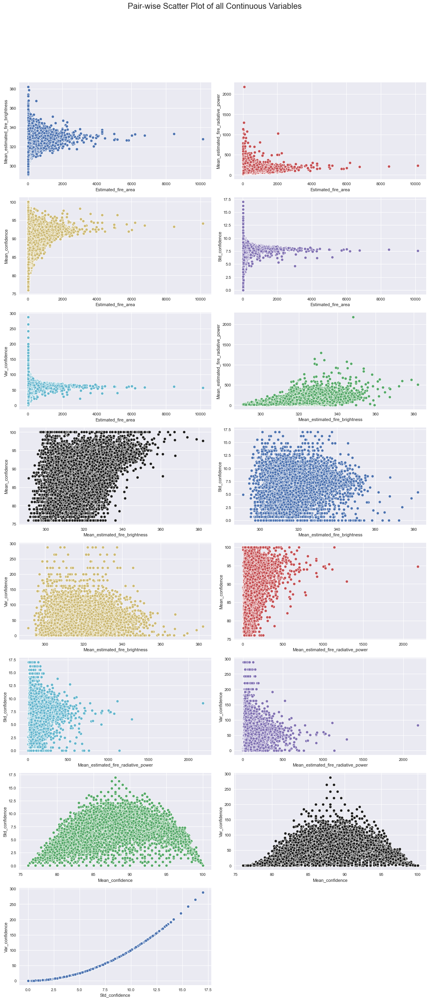

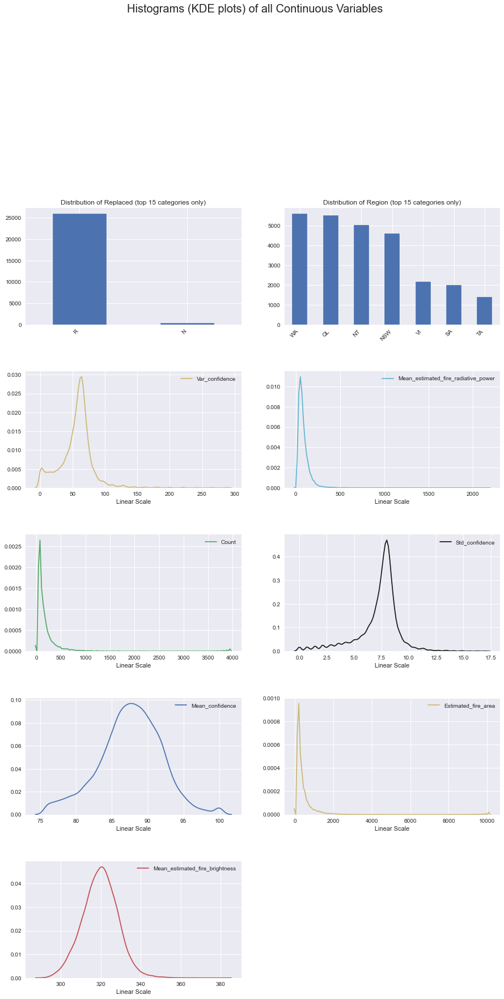

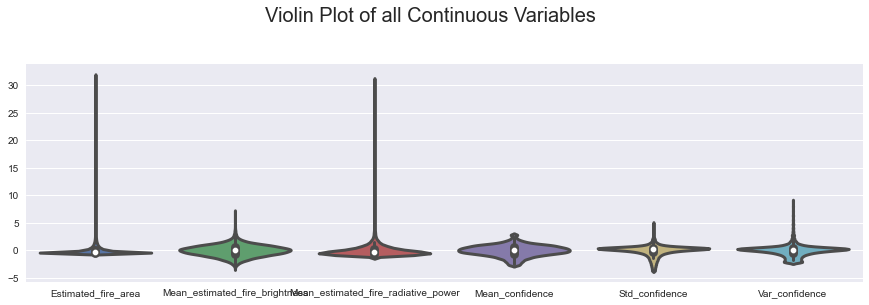

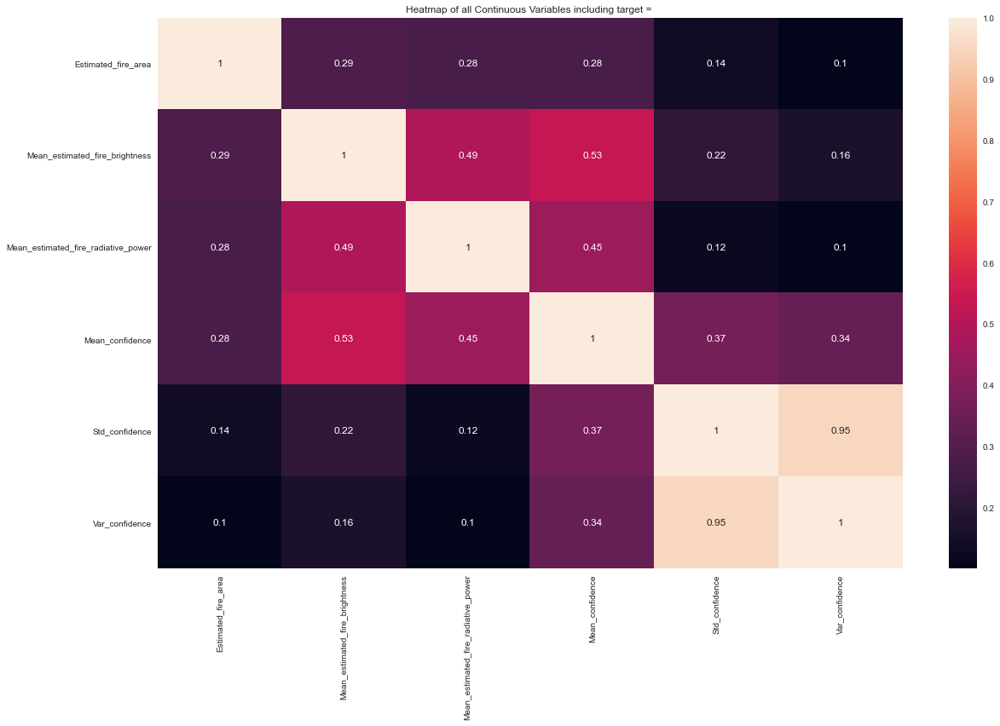

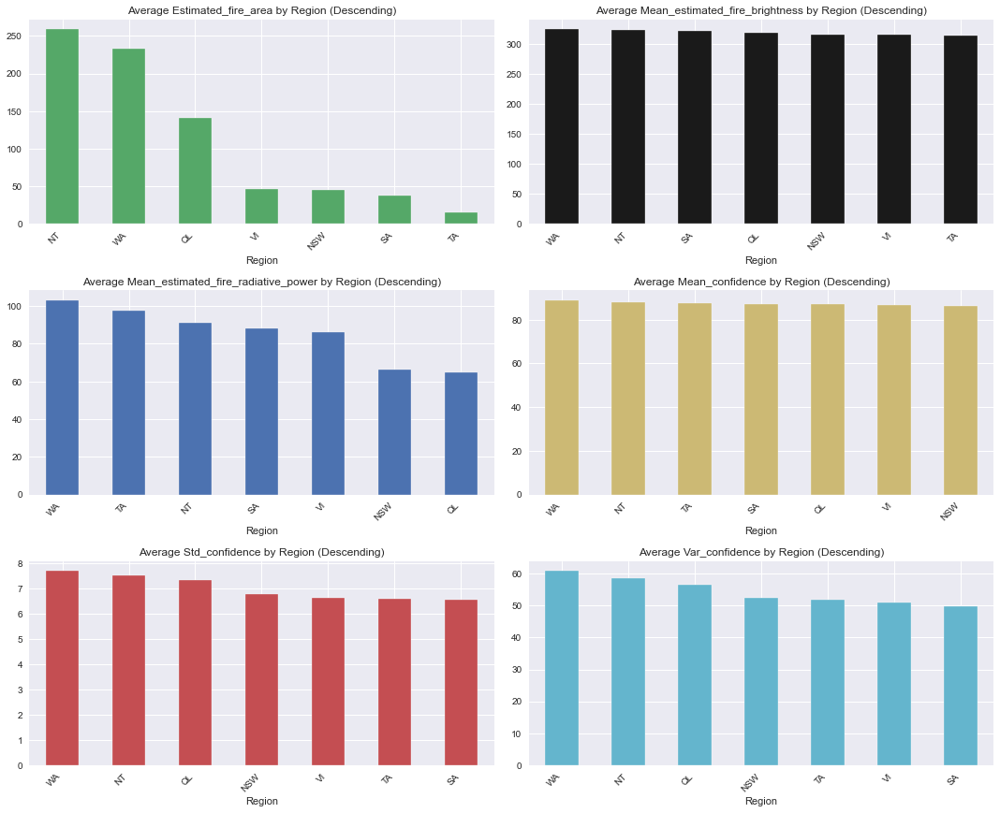

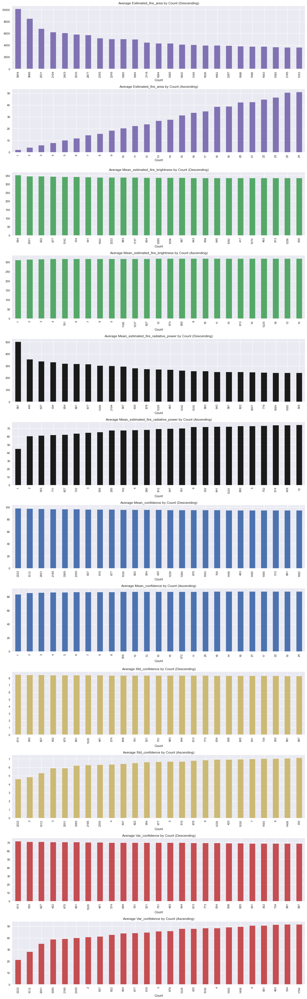

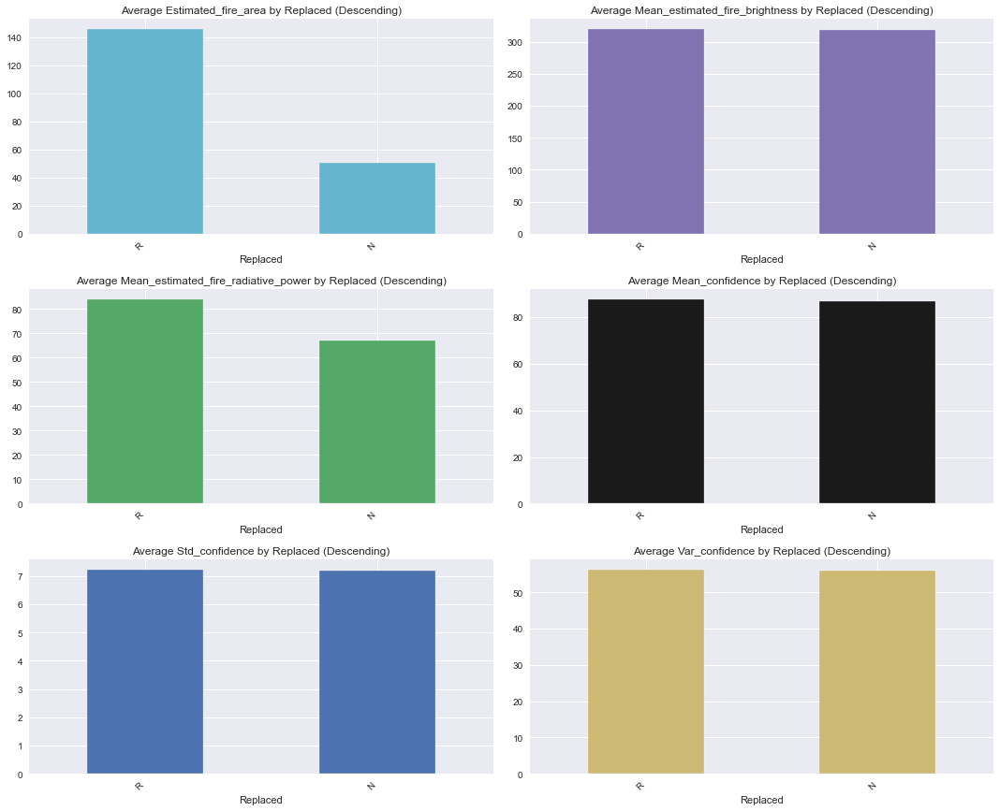

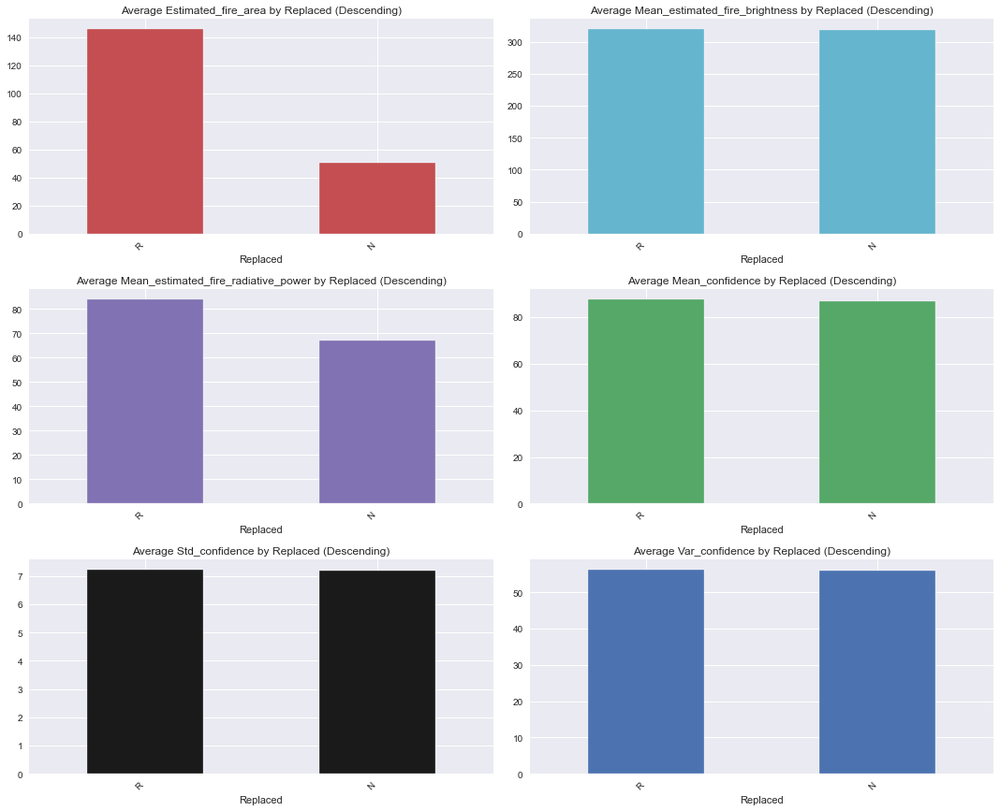

In [3]:
import warnings

warnings.filterwarnings("ignore")
%pip install autoviz
from autoviz.AutoViz_Class import AutoViz_Class
av = AutoViz_Class()
report = av.AutoViz(HistorialWildfires)

In [4]:
import pandas_profiling
Wildfires_Profile = pandas_profiling.ProfileReport(HWildfires_dataset)
display(Wildfires_Profile)

In [6]:
HWildfires_dataset.describe()

,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count
count,26406.000000,26406.000000,26406.000000,26406.000000,24199.000000,24199.000000,26406.000000
mean,144.297966,319.662078,83.621258,87.574735,7.228302,56.229092,72.059305
std,314.453847,8.862005,67.510022,4.371972,1.995221,25.898935,150.973128
min,1.000000,290.700000,0.000000,76.000000,0.000000,0.000000,1.000000
25%,8.911875,313.933333,44.150391,85.000000,6.687010,44.716106,5.000000
50%,38.434091,319.784412,67.133333,87.771429,7.707025,59.398234,20.000000
75%,146.951278,325.403144,103.123611,90.498403,8.236665,67.842642,74.000000
max,10120.943170,381.950000,2178.600000,100.000000,16.970563,288.000000,3954.000000


In [7]:
HWildfires_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26406 entries, 0 to 26405
Data columns (total 10 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Region                               26406 non-null  object 
 1   Date                                 26406 non-null  object 
 2   Estimated_fire_area                  26406 non-null  float64
 3   Mean_estimated_fire_brightness       26406 non-null  float64
 4   Mean_estimated_fire_radiative_power  26406 non-null  float64
 5   Mean_confidence                      26406 non-null  float64
 6   Std_confidence                       24199 non-null  float64
 7   Var_confidence                       24199 non-null  float64
 8   Count                                26406 non-null  int64  
 9   Replaced                             26406 non-null  object 
dtypes: float64(6), int64(1), object(3)
memory usage: 2.0+ MB


In [8]:
HWildfires_dataset.isna().sum()

Region                                    0
Date                                      0
Estimated_fire_area                       0
Mean_estimated_fire_brightness            0
Mean_estimated_fire_radiative_power       0
Mean_confidence                           0
Std_confidence                         2207
Var_confidence                         2207
Count                                     0
Replaced                                  0
dtype: int64

In [21]:
HWildfires_dataset.Date.max()

'9/9/2020'

# Historical_Weather


1. Num variables = 5 ('Parameter', 'area', 'min', 'max', 'mean', '2nd_moment')
2. Category Variables = 3 (Date,Region, Parameters)
3. Date== Min <2005-01-01>, Max <2020-10-31>
4. Region= QL, TA, WA, NT, SA, NSW, VI (Data equally Balanced)
5. Parameters = SoilWaterContent , Precipitation, SolarRadiation, Temperature, WindSpeed 	(Data equally Balanced)
6. No missing values
7. Total observations/ Samples = 242781 with 8 features less than Historical Wildfires <26406 with 10 features>

In [4]:
HWeather_dataset=pd.read_csv(HistoricalWeather)
HWeather_dataset.head()

,Date,Region,Parameter,count()[unit: km^2],min(),max(),mean(),variance()
0,2005-01-01,NSW,Precipitation,800234.348986,0.000000,1.836935,0.044274,0.028362
1,2005-01-01,NSW,RelativeHumidity,800234.348986,13.877194,80.522964,36.355567,253.559937
2,2005-01-01,NSW,SoilWaterContent,800234.348986,0.002245,0.414305,0.170931,0.007758
3,2005-01-01,NSW,SolarRadiation,800234.348986,14.515009,32.169781,26.749389,6.078587
4,2005-01-01,NSW,Temperature,800234.348986,14.485785,35.878704,27.341182,18.562212


In [11]:
import pandas_profiling
Weather_Profile = pandas_profiling.ProfileReport(HWeather_dataset)
display(Weather_Profile)

In [12]:
HWeather_dataset.describe()

,count()[unit: km^2],min(),max(),mean(),variance()
count,2.427810e+05,2.427810e+05,242781.000000,242781.000000,242781.000000
mean,1.100786e+06,9.539068e+00,27.223973,16.682559,39.048502
std,7.955005e+05,1.457288e+01,31.337855,21.045676,94.837253
min,6.778526e+04,-5.055067e+00,0.000000,0.000000,0.000000
25%,2.294532e+05,7.586398e-07,5.494375,0.341322,0.343537
50%,9.913151e+05,2.368203e+00,15.527743,6.709059,2.954298
75%,1.730605e+06,1.409707e+01,32.083908,24.976741,16.555256
max,2.528546e+06,9.027615e+01,509.833069,95.952998,2064.896879


In [13]:
HWeather_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 242781 entries, 0 to 242780
Data columns (total 8 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Date                 242781 non-null  object 
 1   Region               242781 non-null  object 
 2   Parameter            242781 non-null  object 
 3   count()[unit: km^2]  242781 non-null  float64
 4   min()                242781 non-null  float64
 5   max()                242781 non-null  float64
 6   mean()               242781 non-null  float64
 7   variance()           242781 non-null  float64
dtypes: float64(5), object(3)
memory usage: 14.8+ MB


In [15]:
HWeather_dataset.isna().sum()

Date                   0
Region                 0
Parameter              0
count()[unit: km^2]    0
min()                  0
max()                  0
mean()                 0
variance()             0
dtype: int64

In [5]:
# Let rename columns names
HWeather_dataset.columns = ['Date', 'Region', 'Parameter', 'area', 'min', 'max', 'mean', '2nd_moment']
HWeather_dataset.head()

,Date,Region,Parameter,area,min,max,mean,2nd_moment
0,2005-01-01,NSW,Precipitation,800234.348986,0.000000,1.836935,0.044274,0.028362
1,2005-01-01,NSW,RelativeHumidity,800234.348986,13.877194,80.522964,36.355567,253.559937
2,2005-01-01,NSW,SoilWaterContent,800234.348986,0.002245,0.414305,0.170931,0.007758
3,2005-01-01,NSW,SolarRadiation,800234.348986,14.515009,32.169781,26.749389,6.078587
4,2005-01-01,NSW,Temperature,800234.348986,14.485785,35.878704,27.341182,18.562212


# Historical Weather Forecasts

1. Num variables = 5 ('area', 'min_forcast', 'max_forcast', 'mean_forcast', '2nd_moment_forcast')
2. Category Variables = 4 (Date,Region, Parameter, Lead time)
3. Date== Min <2014-01-01>, Max <2020-10-31>
4. Region= QL, TA, WA, NT, SA, NSW, VI (Data equally Balanced)
5. Parameters = RelativeHumidity, Precipitation, SolarRadiation, Temperature, WindSpeed (Data equally Balanced)
6. Lead time= 5 (37.8% = 82168), 10 (31.1%=67601), 15 (31.0%=67440) (More data for Lead time =5)
6. No missing values
7. Total observations/ Samples = 217212 with 9 features less than Historical Wildfires <26406 with 10 features> and # Historical_Weather <242781 with 8 features>

In [45]:
HWForecasts_dataset=pd.read_csv(HistoricalWeatherForecasts)
HWForecasts_dataset.head()

,Date,Region,Parameter,Lead time,count()[unit: km^2],min(),max(),mean(),variance()
0,2014-01-01,NSW,RelativeHumidity,5,8.037682e+05,7.482927,85.021118,28.223569,353.620815
1,2014-01-01,NSW,SolarRadiation,5,8.037682e+05,24.865765,33.557598,31.647308,2.276068
2,2014-01-01,NSW,Temperature,5,8.037682e+05,21.243755,36.929035,30.893523,17.918553
3,2014-01-01,NSW,WindSpeed,5,8.037682e+05,1.593531,6.989559,3.958822,1.334834
4,2014-01-01,NT,RelativeHumidity,5,1.349817e+06,14.796251,73.601479,39.799856,189.805002


In [25]:
import pandas_profiling
WForecasts_Profile = pandas_profiling.ProfileReport(HWForecasts_dataset)
display(WForecasts_Profile)

In [26]:
HWForecasts_dataset.describe()

,Lead time,count()[unit: km^2],min(),max(),mean(),variance()
count,217212.000000,2.172120e+05,217212.000000,217212.000000,217212.000000,2.172120e+05
mean,9.660976,1.101102e+06,10.978384,33.139413,20.205306,3.672121e+02
std,4.135758,7.997239e+05,14.678897,55.526747,25.018023,7.732351e+04
min,5.000000,6.567142e+04,-5.018160,0.000000,0.000000,0.000000e+00
25%,5.000000,2.300457e+05,0.805676,9.633714,3.962613,1.842921e+00
50%,10.000000,9.797103e+05,5.663420,23.250812,15.144843,6.909953e+00
75%,15.000000,1.736319e+06,15.827640,37.971995,29.224723,2.977374e+01
max,15.000000,2.542548e+06,254.096924,10001.387695,5079.335413,2.373057e+07


In [27]:
HWForecasts_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 217212 entries, 0 to 217211
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Date                 217212 non-null  object 
 1   Region               217212 non-null  object 
 2   Parameter            217212 non-null  object 
 3   Lead time            217212 non-null  int64  
 4   count()[unit: km^2]  217212 non-null  float64
 5   min()                217212 non-null  float64
 6   max()                217212 non-null  float64
 7   mean()               217212 non-null  float64
 8   variance()           217212 non-null  float64
dtypes: float64(5), int64(1), object(3)
memory usage: 14.9+ MB


In [28]:
HWForecasts_dataset.isna().sum()

Date                   0
Region                 0
Parameter              0
Lead time              0
count()[unit: km^2]    0
min()                  0
max()                  0
mean()                 0
variance()             0
dtype: int64

In [46]:
# Let rename columns names
HWForecasts_dataset.columns = ['Date', 'Region', 'Parameter', 'Lead_time', 'area', 'min_forcast', 'max_forcast', 'mean_forcast', '2nd_moment_forcast']
HWForecasts_dataset.head()

,Date,Region,Parameter,Lead_time,area,min_forcast,max_forcast,mean_forcast,2nd_moment_forcast
0,2014-01-01,NSW,RelativeHumidity,5,8.037682e+05,7.482927,85.021118,28.223569,353.620815
1,2014-01-01,NSW,SolarRadiation,5,8.037682e+05,24.865765,33.557598,31.647308,2.276068
2,2014-01-01,NSW,Temperature,5,8.037682e+05,21.243755,36.929035,30.893523,17.918553
3,2014-01-01,NSW,WindSpeed,5,8.037682e+05,1.593531,6.989559,3.958822,1.334834
4,2014-01-01,NT,RelativeHumidity,5,1.349817e+06,14.796251,73.601479,39.799856,189.805002


# LandClass

1. Num variables = 11 (Region,Shrubs,Herbaceous_vegetation,cropland,Urban_builtup,sparse_vegetation,Permanent_waterbodies,Herbaceous_wetland,CF_evergreen_broadleaf,CF_deciduous_broadleaf,CF_unknown,OF_evergreen_broadleaf,OF_deciduous_broadleaf,OF_unknown,Open_Sea)
2. Category Variables = 1 (Region)
3. Region= QL, TA, WA, NT, SA, NSW, VI (Data equally Balanced)
4. No missing values
5. Total observations/ Samples = 7 with 15 features

In [33]:
LandClass_dataset=pd.read_csv(LandClass)
LandClass_dataset.head()

,Region,Shrubs,Herbaceous vegetation,Cultivated and managed vegetation/agriculture (cropland),Urban / built up,Bare / sparse vegetation,Permanent water bodies,Herbaceous wetland,"Closed forest, evergreen, broad leaf","Closed forest, deciduous broad leaf","Closed forest, unknown","Open forest, evergreen broad leaf","Open forest, deciduous broad leaf","Open forest, unknown definitions",Open sea
0,NSW,6.2,43.6,13.0,0.3,0.2,0.2,0.1,14.7,6.8,0.3,0.5,3.7,10.3,0.1
1,NT,18.1,48.9,0.1,0.0,0.4,0.1,0.1,1.0,7.7,0.1,0.1,13.6,9.3,0.5
2,QL,9.5,45.3,1.6,0.1,1.1,0.1,0.0,5.3,13.3,0.3,0.1,12.0,11.0,0.3
3,SA,24.1,54.8,5.8,0.1,4.8,1.2,0.1,0.3,1.3,0.1,0.1,1.4,5.3,0.6
4,TA,0.7,23.8,1.2,0.2,0.1,1.9,1.4,50.1,0.6,1.1,7.2,1.5,7.2,3.0


In [34]:
import pandas_profiling
LandClass_Profile = pandas_profiling.ProfileReport(LandClass_dataset)
display(LandClass_Profile)

In [35]:
LandClass_dataset.describe()

,Shrubs,Herbaceous vegetation,Cultivated and managed vegetation/agriculture (cropland),Urban / built up,Bare / sparse vegetation,Permanent water bodies,Herbaceous wetland,"Closed forest, evergreen, broad leaf","Closed forest, deciduous broad leaf","Closed forest, unknown","Open forest, evergreen broad leaf","Open forest, deciduous broad leaf","Open forest, unknown definitions",Open sea
count,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000
mean,13.042857,42.128571,7.228571,0.242857,1.100000,0.642857,0.285714,13.785714,5.128571,0.342857,1.371429,5.671429,8.142857,0.885714
std,11.750441,10.060436,8.317995,0.350510,1.683251,0.675419,0.501427,18.246500,4.482453,0.345722,2.620887,5.033791,2.312904,0.971989
min,0.700000,23.800000,0.100000,0.000000,0.100000,0.100000,0.000000,0.300000,0.600000,0.100000,0.100000,1.400000,5.200000,0.100000
25%,3.800000,39.250000,1.400000,0.050000,0.150000,0.150000,0.050000,1.100000,1.850000,0.150000,0.100000,2.100000,6.250000,0.400000
50%,9.500000,43.600000,5.600000,0.100000,0.400000,0.400000,0.100000,5.300000,3.800000,0.300000,0.100000,3.700000,8.700000,0.600000
75%,21.100000,47.100000,9.400000,0.250000,1.050000,0.900000,0.200000,19.300000,7.250000,0.300000,1.000000,8.400000,9.800000,0.850000
max,31.300000,54.800000,23.300000,1.000000,4.800000,1.900000,1.400000,50.100000,13.300000,1.100000,7.200000,13.600000,11.000000,3.000000


In [36]:
LandClass_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 15 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Region                                                    7 non-null      object 
 1   Shrubs                                                    7 non-null      float64
 2   Herbaceous vegetation                                     7 non-null      float64
 3   Cultivated and managed vegetation/agriculture (cropland)  7 non-null      float64
 4   Urban / built up                                          7 non-null      float64
 5   Bare / sparse vegetation                                  7 non-null      float64
 6   Permanent water bodies                                    7 non-null      float64
 7   Herbaceous wetland                                        7 non-null      float64
 8   Closed forest, evergreen

In [37]:
LandClass_dataset.isna().sum()

Region                                                      0
Shrubs                                                      0
Herbaceous vegetation                                       0
Cultivated and managed vegetation/agriculture (cropland)    0
Urban / built up                                            0
Bare / sparse vegetation                                    0
Permanent water bodies                                      0
Herbaceous wetland                                          0
Closed forest, evergreen, broad leaf                        0
Closed forest, deciduous broad leaf                         0
Closed forest, unknown                                      0
Open forest, evergreen broad leaf                           0
Open forest, deciduous broad leaf                           0
Open forest, unknown definitions                            0
Open sea                                                    0
dtype: int64

In [38]:
# Let's rename columns names--> OF=Open Forest, CF= Closed Forest.
LandClass_dataset.columns = ['Region','Shrubs','Herbaceous_vegetation','cropland','Urban_builtup','sparse_vegetation','Permanent_waterbodies','Herbaceous_wetland','CF_evergreen_broadleaf','CF_deciduous_broadleaf','CF_unknown','OF_evergreen_broadleaf','OF_deciduous_broadleaf','OF_unknown','Open_Sea']
LandClass_dataset.head()



,Region,Shrubs,Herbaceous_vegetation,cropland,Urban_builtup,sparse_vegetation,Permanent_waterbodies,Herbaceous_wetland,CF_evergreen_broadleaf,CF_deciduous_broadleaf,CF_unknown,OF_evergreen_broadleaf,OF_deciduous_broadleaf,OF_unknown,Open_Sea
0,NSW,6.2,43.6,13.0,0.3,0.2,0.2,0.1,14.7,6.8,0.3,0.5,3.7,10.3,0.1
1,NT,18.1,48.9,0.1,0.0,0.4,0.1,0.1,1.0,7.7,0.1,0.1,13.6,9.3,0.5
2,QL,9.5,45.3,1.6,0.1,1.1,0.1,0.0,5.3,13.3,0.3,0.1,12.0,11.0,0.3
3,SA,24.1,54.8,5.8,0.1,4.8,1.2,0.1,0.3,1.3,0.1,0.1,1.4,5.3,0.6
4,TA,0.7,23.8,1.2,0.2,0.1,1.9,1.4,50.1,0.6,1.1,7.2,1.5,7.2,3.0


In [39]:
LandClass_dataset.isna().sum()

Region                    0
Shrubs                    0
Herbaceous_vegetation     0
cropland                  0
Urban_builtup             0
sparse_vegetation         0
Permanent_waterbodies     0
Herbaceous_wetland        0
CF_evergreen_broadleaf    0
CF_deciduous_broadleaf    0
CF_unknown                0
OF_evergreen_broadleaf    0
OF_deciduous_broadleaf    0
OF_unknown                0
Open_Sea                  0
dtype: int64

# VegetationIndex

1. Num variables = 5 (Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance)
2. Category Variables = 2 (Date, Region)
3. Region= QL, TA, WA, NT, SA, NSW, VI (Data equally Balanced)
4. No missing values
5. Total observations/ Samples = 1330 with 7 features
6. Vegetation_index_std and Vegetation_index_variance are strongly Positively correlated while 
   Vegetation_index_std and Vegetation_index_mean are also enough Positively correlated
7. Date--> min <2005-01-01>, max <2020-09-01>... Frequency Monthly once


In [40]:
Vegetation_dataset=pd.read_csv(VegetationIndex)
Vegetation_dataset.head()

,Region,Date,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance
0,NSW,1/1/2005,0.349202,0.9972,-0.2,0.204862,0.041968
1,NSW,2/1/2005,0.357403,0.9772,-0.2,0.208673,0.043544
2,NSW,3/1/2005,0.354087,0.9750,-0.2,0.209450,0.043869
3,NSW,4/1/2005,0.347242,0.9904,-0.2,0.207307,0.042976
4,NSW,5/1/2005,0.345526,0.9972,-0.2,0.202858,0.041151


In [41]:
import pandas_profiling
Vegetation_Profile = pandas_profiling.ProfileReport(Vegetation_dataset)
display(Vegetation_Profile)

In [42]:
Vegetation_dataset.describe()

,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance
count,1330.000000,1330.000000,1330.000000,1330.000000,1330.000000
mean,0.388447,1.001495,-0.224125,0.156684,0.026372
std,0.159559,0.041713,0.044041,0.042707,0.013333
min,0.153144,0.521000,-0.588200,0.048311,0.002334
25%,0.261662,0.981625,-0.244000,0.118583,0.014062
50%,0.343018,0.992000,-0.200000,0.161376,0.026042
75%,0.486939,0.998475,-0.200000,0.191044,0.036498
max,0.757761,1.222200,-0.195900,0.367723,0.135220


In [43]:
Vegetation_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1330 entries, 0 to 1329
Data columns (total 7 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Region                     1330 non-null   object 
 1   Date                       1330 non-null   object 
 2   Vegetation_index_mean      1330 non-null   float64
 3   Vegetation_index_max       1330 non-null   float64
 4   Vegetation_index_min       1330 non-null   float64
 5   Vegetation_index_std       1330 non-null   float64
 6   Vegetation_index_variance  1330 non-null   float64
dtypes: float64(5), object(2)
memory usage: 72.9+ KB


In [44]:
Vegetation_dataset.isna().sum()

Region                       0
Date                         0
Vegetation_index_mean        0
Vegetation_index_max         0
Vegetation_index_min         0
Vegetation_index_std         0
Vegetation_index_variance    0
dtype: int64

In [46]:
Vegetation_dataset.Date.max()

'9/1/2020'

In [ ]:
#Summary on data sheets provided

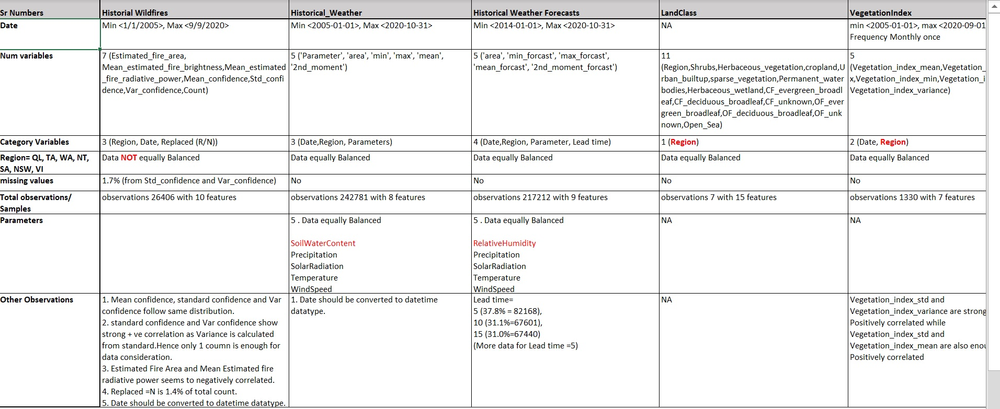

# Data Mergers


In [9]:
HWeather_dataset.head()

,Date,Region,Parameter,area,min,max,mean,2nd_moment
0,2005-01-01,NSW,Precipitation,800234.348986,0.000000,1.836935,0.044274,0.028362
1,2005-01-01,NSW,RelativeHumidity,800234.348986,13.877194,80.522964,36.355567,253.559937
2,2005-01-01,NSW,SoilWaterContent,800234.348986,0.002245,0.414305,0.170931,0.007758
3,2005-01-01,NSW,SolarRadiation,800234.348986,14.515009,32.169781,26.749389,6.078587
4,2005-01-01,NSW,Temperature,800234.348986,14.485785,35.878704,27.341182,18.562212


df.pivot_table(values=[],index=[],columns=[])

In [11]:
Hist_Weather_Pivot = HWeather_dataset.pivot_table(values=['min','max','mean','2nd_moment'],index=['Date','Region','area'],columns=['Parameter'])
Hist_Weather_Pivot

2nd_moment                   \
Parameter                      Precipitation RelativeHumidity   
Date       Region area                                          
2005-01-01 NSW    8.002343e+05      0.028362       253.559937   
           NT     1.357561e+06    546.059262       584.201131   
           QL     1.730605e+06     35.641257       403.134377   
           SA     9.913151e+05      0.042837       246.044713   
           TA     6.778526e+04     12.068597       111.754034   
...                                      ...              ...   
2020-10-31 QL     1.730605e+06      4.229566       316.368911   
           SA     9.913151e+05      0.000492       316.308826   
           TA     6.778526e+04      0.243603        10.936866   
           VI     2.294532e+05      3.148454        44.766480   
           WA     2.528546e+06      2.097161       309.018764   

                                                                            \
Parameter                      SoilWaterContent SolarRadiation Temperature   
Date       Region area                                                       
2005-01-01 NSW    8.002343e+05         0.007758       6.078587   18.562212   
           NT     1.357561e+06         0.026743      58.942658   12.920252   
           QL     1.730605e+06         0.012679      29.500832   13.792599   
           SA     9.913151e+05         0.001917       7.914246   34.799336   
           TA     6.778526e+04         0.007121      12.826400    4.912013   
...                                         ...            ...         ...   
2020-10-31 QL     1.730605e+06         0.006935       4.796284    8.811943   
           SA     9.913151e+05         0.005425      17.093209    9.466862   
           TA     6.778526e+04         0.009317       8.718983    2.388990   
           VI     2.294532e+05         0.005050       9.917196    4.088503   
           WA     2.528546e+06         0.001419       5.986063   15.293953   

                                                   max                   \
Parameter                      WindSpeed Precipitation RelativeHumidity   
Date       Region area                                                    
2005-01-01 NSW    8.002343e+05  0.850048      1.836935        80.522964   
           NT     1.357561e+06  1.930014    315.266815        95.683342   
           QL     1.730605e+06  0.883048     74.452164        95.898270   
           SA     9.913151e+05  1.655908      3.193624        81.980751   
           TA     6.778526e+04  2.963118     13.604791        81.501442   
...                                  ...           ...              ...   
2020-10-31 QL     1.730605e+06  0.549077     26.366877        87.803581   
           SA     9.913151e+05  0.640926      0.259189        82.642616   
           TA     6.778526e+04  0.859296      2.179307        86.428932   
           VI     2.294532e+05  1.019079     11.436618        93.374763   
           WA     2.528546e+06  1.873607     15.154541        82.022224   

                                                                ...  \
Parameter                      SoilWaterContent SolarRadiation  ...   
Date       Region area                                          ...   
2005-01-01 NSW    8.002343e+05         0.414305      32.169781  ...   
           NT     1.357561e+06         0.496140      31.634459  ...   
           QL     1.730605e+06         0.472416      31.982830  ...   
           SA     9.913151e+05         0.263911      31.734528  ...   
           TA     6.778526e+04         0.368189      33.225517  ...   
...                                         ...            ...  ...   
2020-10-31 QL     1.730605e+06         0.442840      30.670065  ...   
           SA     9.913151e+05         0.436347      29.623133  ...   
           TA     6.778526e+04         0.376833      28.439209  ...   
           VI     2.294532e+05         0.455111      28.041906  ...   
           WA     2.528546e+06         0.285399      29.

In [13]:
# Reset dataframe index
Hist_Weather_Pivot.reset_index(inplace= True)
Hist_Weather_Pivot

Date Region          area    2nd_moment                   \
Parameter                                  Precipitation RelativeHumidity   
0          2005-01-01    NSW  8.002343e+05      0.028362       253.559937   
1          2005-01-01     NT  1.357561e+06    546.059262       584.201131   
2          2005-01-01     QL  1.730605e+06     35.641257       403.134377   
3          2005-01-01     SA  9.913151e+05      0.042837       246.044713   
4          2005-01-01     TA  6.778526e+04     12.068597       111.754034   
...               ...    ...           ...           ...              ...   
40476      2020-10-31     QL  1.730605e+06      4.229566       316.368911   
40477      2020-10-31     SA  9.913151e+05      0.000492       316.308826   
40478      2020-10-31     TA  6.778526e+04      0.243603        10.936866   
40479      2020-10-31     VI  2.294532e+05      3.148454        44.766480   
40480      2020-10-31     WA  2.528546e+06      2.097161       309.018764   

                                                                          max  \
Parameter SoilWaterContent SolarRadiation Temperature WindSpeed Precipitation   
0                 0.007758       6.078587   18.562212  0.850048      1.836935   
1                 0.026743      58.942658   12.920252  1.930014    315.266815   
2                 0.012679      29.500832   13.792599  0.883048     74.452164   
3                 0.001917       7.914246   34.799336  1.655908      3.193624   
4                 0.007121      12.826400    4.912013  2.963118     13.604791   
...                    ...            ...         ...       ...           ...   
40476             0.006935       4.796284    8.811943  0.549077     26.366877   
40477             0.005425      17.093209    9.466862  0.640926      0.259189   
40478             0.009317       8.718983    2.388990  0.859296      2.179307   
40479             0.005050       9.917196    4.088503  1.019079     11.436618   
40480             0.001419       5.986063   15.293953  1.873607     15.154541   

           ...             mean                                       \
Parameter  ... SoilWaterContent SolarRadiation Temperature WindSpeed   
0          ...         0.170931      26.749389   27.341182  3.323550   
1          ...         0.167735      19.781791   29.881492  5.296892   
2          ...         0.185641      27.056979   28.842866  3.483753   
3          ...         0.056047      27.142643   30.793675  4.657538   
4          ...         0.211360      26.755711   11.788805  5.408138   
...        ...              ...            ...         ...       ...   
40476      ...         0.141467      28.745128   24.777835  3.137745   
40477      ...         0.083082      26.530568   18.947783  3.548225   
40478      ...         0.264608      21.782732   11.648813  2.501697   
40479      ...         0.324260      19.553751   13.167147  3.838360   
40480      ...         0.050737      26.746413   28.090392  4.373947   

                    min                                                   \
Parameter Precipitation RelativeHumidity SoilWaterContent SolarRadiation   
0              0.000000        13.877194         0.002245      14.515009   
1              0.000000        14.558820         0.000000       2.518120   
2              0.000000        14.443199         0.000000       6.033827   
3              0.000000        10.618136         0.000000      17.861103   
4              0.003973        43.906574         0.000000      20.742302   
...                 ...              ...              ...            ...   
40476          0.000000        12.749949         0.000000      19.898029   
40477          0.000000        12.512371         0.000000      15.608338   
40478          0.000703        69.801094         0.000000      15.503663   
40479          0.000000        66.459290         0.000000      11.170260   
40480          0.000000         9.272744         0.000000      17.072290   

                                 
P

In [14]:
# Renaming Column names
Hist_Weather_Pivot.columns = [col[0] if not(col[1]) else '{1}_{0}'.format(*col) for col in Hist_Weather_Pivot.columns.values]
Hist_Weather_Pivot.head()

,Date,Region,area,Precipitation_2nd_moment,RelativeHumidity_2nd_moment,SoilWaterContent_2nd_moment,SolarRadiation_2nd_moment,Temperature_2nd_moment,WindSpeed_2nd_moment,Precipitation_max,...,SoilWaterContent_mean,SolarRadiation_mean,Temperature_mean,WindSpeed_mean,Precipitation_min,RelativeHumidity_min,SoilWaterContent_min,SolarRadiation_min,Temperature_min,WindSpeed_min
0,2005-01-01,NSW,8.002343e+05,0.028362,253.559937,0.007758,6.078587,18.562212,0.850048,1.836935,...,0.170931,26.749389,27.341182,3.323550,0.000000,13.877194,0.002245,14.515009,14.485785,1.354448
1,2005-01-01,NT,1.357561e+06,546.059262,584.201131,0.026743,58.942658,12.920252,1.930014,315.266815,...,0.167735,19.781791,29.881492,5.296892,0.000000,14.558820,0.000000,2.518120,24.179960,1.840394
2,2005-01-01,QL,1.730605e+06,35.641257,403.134377,0.012679,29.500832,13.792599,0.883048,74.452164,...,0.185641,27.056979,28.842866,3.483753,0.000000,14.443199,0.000000,6.033827,20.951620,1.106028
3,2005-01-01,SA,9.913151e+05,0.042837,246.044713,0.001917,7.914246,34.799336,1.655908,3.193624,...,0.056047,27.142643,30.793675,4.657538,0.000000,10.618136,0.000000,17.861103,14.095855,2.023657
4,2005-01-01,TA,6.778526e+04,12.068597,111.754034,0.007121,12.826400,4.912013,2.963118,13.604791,...,0.211360,26.755711,11.788805,5.408138,0.003973,43.906574,0.000000,20.742302,6.686816,1.995647


In [15]:
# Rearranging Data and column
params = Hist_Weather_Pivot.columns.tolist()[3:]
params.sort()
Hist_weather_data = Hist_Weather_Pivot[Hist_Weather_Pivot.columns.tolist()[:3] + params].copy()
Hist_weather_data.head()

,Date,Region,area,Precipitation_2nd_moment,Precipitation_max,Precipitation_mean,Precipitation_min,RelativeHumidity_2nd_moment,RelativeHumidity_max,RelativeHumidity_mean,...,SolarRadiation_mean,SolarRadiation_min,Temperature_2nd_moment,Temperature_max,Temperature_mean,Temperature_min,WindSpeed_2nd_moment,WindSpeed_max,WindSpeed_mean,WindSpeed_min
0,2005-01-01,NSW,8.002343e+05,0.028362,1.836935,0.044274,0.000000,253.559937,80.522964,36.355567,...,26.749389,14.515009,18.562212,35.878704,27.341182,14.485785,0.850048,7.670482,3.323550,1.354448
1,2005-01-01,NT,1.357561e+06,546.059262,315.266815,9.884958,0.000000,584.201131,95.683342,61.494675,...,19.781791,2.518120,12.920252,38.136787,29.881492,24.179960,1.930014,9.704402,5.296892,1.840394
2,2005-01-01,QL,1.730605e+06,35.641257,74.452164,1.453053,0.000000,403.134377,95.898270,47.959364,...,27.056979,6.033827,13.792599,37.047943,28.842866,20.951620,0.883048,7.675632,3.483753,1.106028
3,2005-01-01,SA,9.913151e+05,0.042837,3.193624,0.059078,0.000000,246.044713,81.980751,30.057683,...,27.142643,17.861103,34.799336,38.326847,30.793675,14.095855,1.655908,10.044715,4.657538,2.023657
4,2005-01-01,TA,6.778526e+04,12.068597,13.604791,3.099497,0.003973,111.754034,81.501442,65.086764,...,26.755711,20.742302,4.912013,16.228510,11.788805,6.686816,2.963118,11.432408,5.408138,1.995647


In [19]:
HWeather_dataset.shape

(242781, 8)

In [20]:
Hist_weather_data.shape

(40481, 27)

In [47]:
HWForecasts_dataset.head()

,Date,Region,Parameter,Lead_time,area,min_forcast,max_forcast,mean_forcast,2nd_moment_forcast
0,2014-01-01,NSW,RelativeHumidity,5,8.037682e+05,7.482927,85.021118,28.223569,353.620815
1,2014-01-01,NSW,SolarRadiation,5,8.037682e+05,24.865765,33.557598,31.647308,2.276068
2,2014-01-01,NSW,Temperature,5,8.037682e+05,21.243755,36.929035,30.893523,17.918553
3,2014-01-01,NSW,WindSpeed,5,8.037682e+05,1.593531,6.989559,3.958822,1.334834
4,2014-01-01,NT,RelativeHumidity,5,1.349817e+06,14.796251,73.601479,39.799856,189.805002


In [48]:
HWForecasts_dataset.shape

(217212, 9)

From Historical_Weather_Forecasts_readme.txt: "The Lead time = 15 forecast for Precipitation for 2017-10-06 is clearly an outlier. We have left it in the data, yet most users will want to remove it."

In [49]:
Outlier1 = HWForecasts_dataset.loc[(HWForecasts_dataset.Date == "2017-10-06")&(HWForecasts_dataset.Parameter == "Precipitation")&(HWForecasts_dataset.Lead_time == 15)]
Outlier1

,Date,Region,Parameter,Lead_time,area,min_forcast,max_forcast,mean_forcast,2nd_moment_forcast
100641,2017-10-06,NSW,Precipitation,15,7.725261e+05,250.288422,8210.618164,316.547930,2.902702e+05
100656,2017-10-06,NT,Precipitation,15,9.152510e+05,252.940247,10001.387695,1671.411758,1.077077e+07
100671,2017-10-06,QL,Precipitation,15,4.590840e+05,254.096924,10000.420898,5079.335413,2.373057e+07
100686,2017-10-06,SA,Precipitation,15,7.573878e+05,250.923462,10000.200195,1975.757703,1.319589e+07
100701,2017-10-06,TA,Precipitation,15,6.567142e+04,249.333389,255.055130,250.576076,9.660292e-01
100716,2017-10-06,VI,Precipitation,15,2.300457e+05,250.512894,258.626038,254.752662,3.580460e+00
100731,2017-10-06,WA,Precipitation,15,1.037480e+06,252.199997,10000.639648,3748.751125,2.110331e+07


In [35]:
Outlier1.shape

(7, 9)

In [42]:
Outlier1.index.values

array([100641, 100656, 100671, 100686, 100701, 100716, 100731],
      dtype=int64)

In [54]:
HWForecasts_dataset.index[(HWForecasts_dataset.Date == "2017-10-06")&(HWForecasts_dataset.Parameter == "Precipitation")&(HWForecasts_dataset.Lead_time == 15)]

Int64Index([100641, 100656, 100671, 100686, 100701, 100716, 100731], dtype='int64')

In [59]:
HWForecasts_dataset.drop(HWForecasts_dataset.index[(HWForecasts_dataset.Date == "2017-10-06")&(HWForecasts_dataset.Parameter == "Precipitation")&(HWForecasts_dataset.Lead_time == 15)], inplace=True)

In [60]:
num_rows, num_cols = HWForecasts_dataset.shape
print("There are total {} records in the following {} columns:\n".format(num_rows, num_cols))
print("\n".join(list(HWForecasts_dataset.columns)))

There are total 217205 records in the following 9 columns:

Date
Region
Parameter
Lead_time
area
min_forcast
max_forcast
mean_forcast
2nd_moment_forcast


In [61]:
HWForecasts_dataset.shape

(217205, 9)

In [64]:
Hist_Weather_forecast_pivot=HWForecasts_dataset.pivot_table(values=['min_forcast','max_forcast','mean_forcast','2nd_moment_forcast'],index=['Date','Region','Lead_time','area'],columns=['Parameter'])
Hist_Weather_forecast_pivot

2nd_moment_forcast                   \
Parameter                                     Precipitation RelativeHumidity   
Date       Region Lead_time area                                               
2014-01-01 NSW    5         8.037682e+05                NaN       353.620815   
           NT     5         1.349817e+06                NaN       189.805002   
           QL     5         1.736319e+06                NaN       470.624907   
           SA     5         9.797103e+05                NaN       275.718715   
           TA     5         6.567142e+04                NaN        12.570180   
...                                                     ...              ...   
2020-10-31 VI     10        2.300457e+05           0.226294        71.399972   
                  15        2.300457e+05           1.064420       231.553974   
           WA     5         2.542548e+06           1.479139       200.508811   
                  10        2.542548e+06           0.146198       214.113833   
                  15        2.542548e+06           1.486440       215.907616   

                                                                     \
Parameter                                SolarRadiation Temperature   
Date       Region Lead_time area                                      
2014-01-01 NSW    5         8.037682e+05       2.276068   17.918553   
           NT     5         1.349817e+06       6.573279    6.605778   
           QL     5         1.736319e+06       7.079362   22.150075   
           SA     5         9.797103e+05      30.069684   15.097683   
           TA     5         6.567142e+04       9.588782    2.292068   
...                                                 ...         ...   
2020-10-31 VI     10        2.300457e+05      15.359641    7.669216   
                  15        2.300457e+05      25.315183    9.185775   
           WA     5         2.542548e+06       8.996331   14.749877   
                  10        2.542548e+06       2.844737   14.610838   
                  15        2.542548e+06      12.547091   32.340741   

                                                      max_forcast  \
Parameter                                 WindSpeed Precipitation   
Date       Region Lead_time area                                    
2014-01-01 NSW    5         8.037682e+05   1.334834           NaN   
           NT     5         1.349817e+06   4.871655           NaN   
           QL     5         1.736319e+06   1.352935           NaN   
           SA     5         9.797103e+05  10.752086           NaN   
           TA     5         6.567142e+04   1.000159           NaN   
...                                             ...           ...   
2020-10-31 VI     10        2.300457e+05   1.141684      3.754553   
                  15        2.300457e+05   0.332452      5.357795   
           WA     5         2.542548e+06   2.626650      9.332361   
                  10        2.542548e+06   2.232168      2.732273   
                  15        2.542548e+06   2.859307     17.224161   

                                                                          \
Parameter                                RelativeHumidity SolarRadiation   
Date       Region Lead_time area                                           
2014-01-01 NSW    5         8.037682e+05        85.021118      33.557598   
           NT     5         1.349817e+06        73.601479      32.766205   
           QL     5         1.736319e+06        83.466888      33.518051   
           SA     5         9.797103e+05        75.290993      33.439438   
           TA     5         6.567142e+04        92.093201      22.283730   
...                                                   ...            ...   
2020-10-31 VI     10        2.300457e+05        91.215370      38.469955   
                  15        2.300457e+05        93.267899      39.743999   
           WA     5         2.542548e+06        81.588310      30.319111   
                  10        2.542548e+06      

In [65]:
#Reset index
Hist_Weather_forecast_pivot.reset_index(inplace=True)
Hist_Weather_forecast_pivot.head()

Date Region Lead_time          area 2nd_moment_forcast  \
Parameter                                                 Precipitation   
0          2014-01-01    NSW         5  8.037682e+05                NaN   
1          2014-01-01     NT         5  1.349817e+06                NaN   
2          2014-01-01     QL         5  1.736319e+06                NaN   
3          2014-01-01     SA         5  9.797103e+05                NaN   
4          2014-01-01     TA         5  6.567142e+04                NaN   

                                                                  \
Parameter RelativeHumidity SolarRadiation Temperature  WindSpeed   
0               353.620815       2.276068   17.918553   1.334834   
1               189.805002       6.573279    6.605778   4.871655   
2               470.624907       7.079362   22.150075   1.352935   
3               275.718715      30.069684   15.097683  10.752086   
4                12.570180       9.588782    2.292068   1.000159   

            max_forcast  ...  mean_forcast                                  \
Parameter Precipitation  ... Precipitation RelativeHumidity SolarRadiation   
0                   NaN  ...           NaN        28.223569      31.647308   
1                   NaN  ...           NaN        39.799856      28.016282   
2                   NaN  ...           NaN        40.504877      30.337689   
3                   NaN  ...           NaN        26.038432      27.126219   
4                   NaN  ...           NaN        85.672655      17.549968   

                                  min_forcast                                  \
Parameter Temperature WindSpeed Precipitation RelativeHumidity SolarRadiation   
0           30.893523  3.958822           NaN         7.482927      24.865765   
1           33.379110  4.740253           NaN        14.796251      18.851019   
2           32.331884  4.178836           NaN         7.028183      17.929157   
3           34.074006  8.630796           NaN         6.606842      11.718054   
4           14.569532  4.831787           NaN        68.435989      12.340322   

                                 
Parameter Temperature WindSpeed  
0           21.243755  1.593531  
1           25.955570  1.192912  
2           22.155766  1.559428  
3           20.889954  2.831450  
4           11.401472  3.079223  

[5 rows x 24 columns]

In [66]:
# Renaming Column names
Hist_Weather_forecast_pivot.columns = [col[0] if not(col[1]) else '{1}_{0}'.format(*col) for col in Hist_Weather_forecast_pivot.columns.values]
Hist_Weather_forecast_pivot.head()

,Date,Region,Lead_time,area,Precipitation_2nd_moment_forcast,RelativeHumidity_2nd_moment_forcast,SolarRadiation_2nd_moment_forcast,Temperature_2nd_moment_forcast,WindSpeed_2nd_moment_forcast,Precipitation_max_forcast,...,Precipitation_mean_forcast,RelativeHumidity_mean_forcast,SolarRadiation_mean_forcast,Temperature_mean_forcast,WindSpeed_mean_forcast,Precipitation_min_forcast,RelativeHumidity_min_forcast,SolarRadiation_min_forcast,Temperature_min_forcast,WindSpeed_min_forcast
0,2014-01-01,NSW,5,8.037682e+05,NaN,353.620815,2.276068,17.918553,1.334834,NaN,...,NaN,28.223569,31.647308,30.893523,3.958822,NaN,7.482927,24.865765,21.243755,1.593531
1,2014-01-01,NT,5,1.349817e+06,NaN,189.805002,6.573279,6.605778,4.871655,NaN,...,NaN,39.799856,28.016282,33.379110,4.740253,NaN,14.796251,18.851019,25.955570,1.192912
2,2014-01-01,QL,5,1.736319e+06,NaN,470.624907,7.079362,22.150075,1.352935,NaN,...,NaN,40.504877,30.337689,32.331884,4.178836,NaN,7.028183,17.929157,22.155766,1.559428
3,2014-01-01,SA,5,9.797103e+05,NaN,275.718715,30.069684,15.097683,10.752086,NaN,...,NaN,26.038432,27.126219,34.074006,8.630796,NaN,6.606842,11.718054,20.889954,2.831450
4,2014-01-01,TA,5,6.567142e+04,NaN,12.570180,9.588782,2.292068,1.000159,NaN,...,NaN,85.672655,17.549968,14.569532,4.831787,NaN,68.435989,12.340322,11.401472,3.079223


In [70]:
# Rearranging Data and column
params = Hist_Weather_forecast_pivot.columns.tolist()[4:]
params.sort()
Hist_Weather_forecast_data = Hist_Weather_forecast_pivot[Hist_Weather_forecast_pivot.columns.tolist()[:4] + params].copy()
Hist_Weather_forecast_data.head()

,Date,Region,Lead_time,area,Precipitation_2nd_moment_forcast,Precipitation_max_forcast,Precipitation_mean_forcast,Precipitation_min_forcast,RelativeHumidity_2nd_moment_forcast,RelativeHumidity_max_forcast,...,SolarRadiation_mean_forcast,SolarRadiation_min_forcast,Temperature_2nd_moment_forcast,Temperature_max_forcast,Temperature_mean_forcast,Temperature_min_forcast,WindSpeed_2nd_moment_forcast,WindSpeed_max_forcast,WindSpeed_mean_forcast,WindSpeed_min_forcast
0,2014-01-01,NSW,5,8.037682e+05,NaN,NaN,NaN,NaN,353.620815,85.021118,...,31.647308,24.865765,17.918553,36.929035,30.893523,21.243755,1.334834,6.989559,3.958822,1.593531
1,2014-01-01,NT,5,1.349817e+06,NaN,NaN,NaN,NaN,189.805002,73.601479,...,28.016282,18.851019,6.605778,39.907539,33.379110,25.955570,4.871655,12.156700,4.740253,1.192912
2,2014-01-01,QL,5,1.736319e+06,NaN,NaN,NaN,NaN,470.624907,83.466888,...,30.337689,17.929157,22.150075,40.503181,32.331884,22.155766,1.352935,7.026765,4.178836,1.559428
3,2014-01-01,SA,5,9.797103e+05,NaN,NaN,NaN,NaN,275.718715,75.290993,...,27.126219,11.718054,15.097683,38.834274,34.074006,20.889954,10.752086,15.038714,8.630796,2.831450
4,2014-01-01,TA,5,6.567142e+04,NaN,NaN,NaN,NaN,12.570180,92.093201,...,17.549968,12.340322,2.292068,20.020470,14.569532,11.401472,1.000159,8.109127,4.831787,3.079223


In [ ]:
Hist_Weather_forecast_data.rename(columns={'area':'area_forcast'},inplace=True)

In [75]:
num_rows, num_cols = Hist_Weather_forecast_data.shape
print("There are total {} records in the following {} columns:\n".format(num_rows, num_cols))
print("\n".join(list(Hist_Weather_forecast_data.columns)))

There are total 44620 records in the following 24 columns:

Date
Region
Lead_time
area_forcast
Precipitation_2nd_moment_forcast
Precipitation_max_forcast
Precipitation_mean_forcast
Precipitation_min_forcast
RelativeHumidity_2nd_moment_forcast
RelativeHumidity_max_forcast
RelativeHumidity_mean_forcast
RelativeHumidity_min_forcast
SolarRadiation_2nd_moment_forcast
SolarRadiation_max_forcast
SolarRadiation_mean_forcast
SolarRadiation_min_forcast
Temperature_2nd_moment_forcast
Temperature_max_forcast
Temperature_mean_forcast
Temperature_min_forcast
WindSpeed_2nd_moment_forcast
WindSpeed_max_forcast
WindSpeed_mean_forcast
WindSpeed_min_forcast


In [76]:
num_rows, num_cols = Hist_weather_data.shape
print("There are total {} records in the following {} columns:\n".format(num_rows, num_cols))
print("\n".join(list(Hist_weather_data.columns)))

There are total 40481 records in the following 27 columns:

Date
Region
area
Precipitation_2nd_moment
Precipitation_max
Precipitation_mean
Precipitation_min
RelativeHumidity_2nd_moment
RelativeHumidity_max
RelativeHumidity_mean
RelativeHumidity_min
SoilWaterContent_2nd_moment
SoilWaterContent_max
SoilWaterContent_mean
SoilWaterContent_min
SolarRadiation_2nd_moment
SolarRadiation_max
SolarRadiation_mean
SolarRadiation_min
Temperature_2nd_moment
Temperature_max
Temperature_mean
Temperature_min
WindSpeed_2nd_moment
WindSpeed_max
WindSpeed_mean
WindSpeed_min


# Let's merge Historical_Weather data with Historical Weather Forecasts.

In [77]:
Histweather_forcastWeather_data = Hist_weather_data.merge(Hist_Weather_forecast_data, how='left', on=['Date', 'Region'])
Histweather_forcastWeather_data.head()

,Date,Region,area,Precipitation_2nd_moment,Precipitation_max,Precipitation_mean,Precipitation_min,RelativeHumidity_2nd_moment,RelativeHumidity_max,RelativeHumidity_mean,...,SolarRadiation_mean_forcast,SolarRadiation_min_forcast,Temperature_2nd_moment_forcast,Temperature_max_forcast,Temperature_mean_forcast,Temperature_min_forcast,WindSpeed_2nd_moment_forcast,WindSpeed_max_forcast,WindSpeed_mean_forcast,WindSpeed_min_forcast
0,2005-01-01,NSW,8.002343e+05,0.028362,1.836935,0.044274,0.000000,253.559937,80.522964,36.355567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2005-01-01,NT,1.357561e+06,546.059262,315.266815,9.884958,0.000000,584.201131,95.683342,61.494675,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2005-01-01,QL,1.730605e+06,35.641257,74.452164,1.453053,0.000000,403.134377,95.898270,47.959364,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2005-01-01,SA,9.913151e+05,0.042837,3.193624,0.059078,0.000000,246.044713,81.980751,30.057683,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2005-01-01,TA,6.778526e+04,12.068597,13.604791,3.099497,0.003973,111.754034,81.501442,65.086764,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [78]:
num_rows, num_cols = Histweather_forcastWeather_data.shape
print("There are total {} records in the following {} columns:\n".format(num_rows, num_cols))
print("\n".join(list(Histweather_forcastWeather_data.columns)))

There are total 67776 records in the following 49 columns:

Date
Region
area
Precipitation_2nd_moment
Precipitation_max
Precipitation_mean
Precipitation_min
RelativeHumidity_2nd_moment
RelativeHumidity_max
RelativeHumidity_mean
RelativeHumidity_min
SoilWaterContent_2nd_moment
SoilWaterContent_max
SoilWaterContent_mean
SoilWaterContent_min
SolarRadiation_2nd_moment
SolarRadiation_max
SolarRadiation_mean
SolarRadiation_min
Temperature_2nd_moment
Temperature_max
Temperature_mean
Temperature_min
WindSpeed_2nd_moment
WindSpeed_max
WindSpeed_mean
WindSpeed_min
Lead_time
area_forcast
Precipitation_2nd_moment_forcast
Precipitation_max_forcast
Precipitation_mean_forcast
Precipitation_min_forcast
RelativeHumidity_2nd_moment_forcast
RelativeHumidity_max_forcast
RelativeHumidity_mean_forcast
RelativeHumidity_min_forcast
SolarRadiation_2nd_moment_forcast
SolarRadiation_max_forcast
SolarRadiation_mean_forcast
SolarRadiation_min_forcast
Temperature_2nd_moment_forcast
Temperature_max_forcast
Temperatu